In [16]:
# Set up libraries and backend
from qiskit.tools.jupyter import * 
from qiskit import IBMQ
from qiskit import assemble
import numpy as np
import matplotlib.pyplot as plt
from qiskit import pulse
from qiskit.pulse import pulse_lib
from qiskit.pulse import Play
from qiskit.pulse.commands import SamplePulse
from qiskit.tools.monitor import job_monitor
from scipy.optimize import curve_fit
import json

%config InlineBackend.figure_format = 'svg'
IBMQ.load_account()
provider = IBMQ.get_provider(hub='ibm-q', group='open', project='main')
backend = provider.get_backend('ibmq_armonk')
backend_config = backend.configuration()
assert backend_config.open_pulse, "Backend doesn't support OpenPulse"

# Use for conversions later
GHz = 1.0e9
MHz = 1.0e6
kHz = 1.0e3
ms = 1.0e-3
us = 1.0e-6
ns = 1.0e-9
scale_factor = 1e-14

# Initialize qubit to |0> and retrieve backend frequencies
qubit = 0
dt = backend_config.dt
backend_defaults = backend.defaults()
qubit_props_dict = backend.properties().qubit_property(0)
rough_qubit_freq = qubit_props_dict['frequency'][0]
rough_cav_freq = backend_defaults.meas_freq_est[qubit]


# Define and configure measurement map (hardware constraint)
meas_map_idx = None
for i, measure_group in enumerate(backend_config.meas_map):
    if qubit in measure_group:
        meas_map_idx = i
        break
assert meas_map_idx is not None, f"Couldn't find qubit {qubit} in meas_map!"
drive_chan = pulse.DriveChannel(qubit)
meas_chan = pulse.MeasureChannel(qubit)
acq_chan = pulse.AcquireChannel(qubit)
qubit_meas_group = backend_config.meas_map[meas_map_idx]
inst_sched_map = backend_defaults.instruction_schedule_map
measure = inst_sched_map.get('measure', qubits=qubit_meas_group)


# Define for convenience
def get_closest_multiple_of_16(num):
    return int(num + 8) - (int(num + 8) % 16)
    
# Save and retrieve data from external text files
def save_data(dataset, file):
    filehandler = open(file, 'w')
    json.dump(dataset, filehandler)
    filehandler.close()

def load_data(file):
    filehandler = open(file)
    dataset = json.load(filehandler)
    filehandler.close()
    return dataset

# Get list of data points (complex-valued) from result of job
def get_job_data(job):
    sweep = []
    result = job.result(timeout=120)
    for i in range(len(result.results)):
        res = result.get_memory(i)*scale_factor
        sweep.append(res[qubit])
    return sweep

# Define curve fitting function
def fit_function(x_values, y_values, function, init_params):
    fitparams, conv = curve_fit(function, x_values, y_values, init_params, maxfev=5000)
    y_fit = function(x_values, *fitparams)
    return fitparams, y_fit

ibmqfactory.load_account:WARNING:2020-08-08 22:17:25,099: Credentials are already in use. The existing account in the session will be replaced.


In [17]:
# Design pi pulse
pi_data = load_data('pipulse.txt')
pi_amp = pi_data["pi_amp"] # from calibration experiment
drive_sigma_us = pi_data["drive_sigma_us"] # Width of the gaussian pulse
drive_samps_us = pi_data["drive_samps_us"] # Truncates duration of gaussian to be finite

drive_sigma = get_closest_multiple_of_16(drive_sigma_us * us /dt)       # Puts width in units of dt
drive_samps = get_closest_multiple_of_16(drive_samps_us * us /dt)   # Puts duration in units of dt
mod_pi_pulse = pulse_lib.gaussian(duration=drive_samps, amp=pi_amp, 
                              sigma=drive_sigma, name='pi_pulse') # build pulse based on amp found

In [18]:
# Build freq array
freq_min_GHz = 5.0
freq_max_GHz = 4.5
num_samps = 50
freq_GHz = np.linspace(freq_min_GHz, freq_max_GHz, num_samps)
freq_Hz = freq_GHz * GHz

# Assign freqs to schedule (for later use)
schedule_freqs = [{drive_chan: freq} for freq in freq_Hz]

In [19]:
# Acquisition + measurement parameters 
meas_amp = 0.3 # medium amplitude
acq_samp_us = 0.5 # on for while to avg out oscillations
meas_sigma_us = 0.01
meas_risefall_us = 0.01

acq_samp = get_closest_multiple_of_16(acq_samp_us * us/dt)
meas_sigma = get_closest_multiple_of_16(meas_sigma_us * us/dt)
meas_risefall = get_closest_multiple_of_16(meas_risefall_us * us/dt)


# Essentially square pulse
meas_pulse = pulse_lib.gaussian_square(duration=acq_samp, amp=meas_amp, sigma=meas_sigma, risefall=meas_risefall)

# Define measurement schedule
meas_schedule = pulse.Schedule(name="Measurement")
meas_schedule += Play(meas_pulse, meas_chan)
meas_schedule += pulse.Acquire(duration=acq_samp, 
                               channel=[pulse.AcquireChannel(i) for i in qubit_meas_group],
                               mem_slot=[pulse.MemorySlot(i) for i in qubit_meas_group])

In [20]:
# Define cavity drive parameters
cav_amp = 1.0 # largest amplitude, limit duration accordingly based on memory considerations
num_durs = 32 # large number that allows all durs to be integer multiples of dt (in order for pulse to build)

cav_dur_us_min = 1.0
cav_dur_us_max = 6.0

cav_durs_us = np.linspace(cav_dur_us_min, cav_dur_us_max, num_durs, endpoint=False) # Vary cavity drive duration 
cav_durs = [get_closest_multiple_of_16(dur_us * us/dt) for dur_us in cav_durs_us]
cav_durs # Check to make sure all are integer valued

[4496,
 5200,
 5904,
 6608,
 7312,
 8016,
 8720,
 9424,
 10128,
 10832,
 11536,
 12240,
 12944,
 13648,
 14336,
 15040,
 15744,
 16448,
 17152,
 17856,
 18560,
 19264,
 19968,
 20672,
 21376,
 22080,
 22784,
 23488,
 24192,
 24896,
 25600,
 26304]

In [21]:
# Construct schedules, one for each cavity power amplitude
schedules = []
for dur in cav_durs:
    dur0 = int(dur) # cast to integer just in case
    dur1 = dur0 - drive_samps # set up pi pulse to finish when cavity drive finishes
    master_schedule = pulse.Schedule(name="Master")
    cavity_pulse = pulse_lib.gaussian_square(duration=dur0, amp=cav_amp, sigma=meas_sigma, risefall=meas_risefall)
    master_schedule += Play(cavity_pulse, meas_chan)
    master_schedule += Play(mod_pi_pulse, drive_chan) << dur1
    master_schedule += meas_schedule # Measure immediately after pi pulse
    schedules.append(master_schedule)

In [22]:
# Draw sample schedules
schedules[31].draw()

In [23]:
num_shots = 1024
programs = [] # Stores qobj for each amplitude
for sched in schedules: 
    program = assemble(sched, backend=backend, meas_level=1, 
                       meas_return='avg', shots=num_shots, schedule_los=schedule_freqs)
    programs.append(program)

In [24]:
jobs = [] # Stores job info for each amp
job_IDs = [] # Stores corresponding job IDs
counter = 0

for program in programs: 
    counter += 1 # Keeps track of job number for execution in for loop
    job = backend.run(program)
    tag = job.job_id()
    print (f"{tag} is job number {counter}")
    job_monitor(job)
    print (f"Job {counter} has error: {job.error_message()}")
    jobs.append(job)
    job_IDs.append(tag)

5f2f5cbccc0ccf001946f525 is job number 1
Job Status: job has successfully run
Job 1 has error: None
5f2f5d2d1676e8001ac095cd is job number 2
Job Status: job has successfully run
Job 2 has error: None
5f2f5da75cf07d001944113e is job number 3
Job Status: job has successfully run
Job 3 has error: None
5f2f5e3f99148e001913011e is job number 4
Job Status: job has successfully run
Job 4 has error: None
5f2f5ee699148e0019130124 is job number 5
Job Status: job has successfully run
Job 5 has error: None
5f2f5f9575f180001a56e849 is job number 6
Job Status: job has successfully run
Job 6 has error: None
5f2f605075f180001a56e851 is job number 7
Job Status: job has successfully run
Job 7 has error: None
5f2f60c8385d440019c43b87 is job number 8
Job Status: job has successfully run
Job 8 has error: None
5f2f618d764208001a73f666 is job number 9
Job Status: job has successfully run
Job 9 has error: None
5f2f625a75f180001a56e860 is job number 10
Job Status: job has successfully run
Job 10 has error: Non

In [35]:
# Extract results
real_sweeps = []
for job in jobs:
    real_sweep = np.real(get_job_data(job))
    real_sweeps.append(real_sweep)

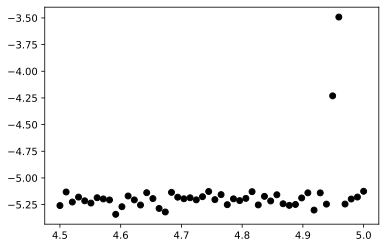

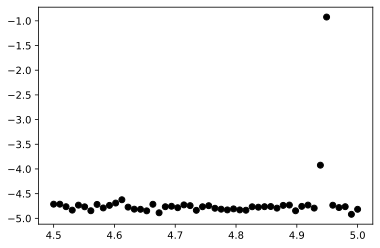

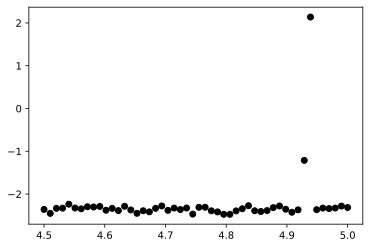

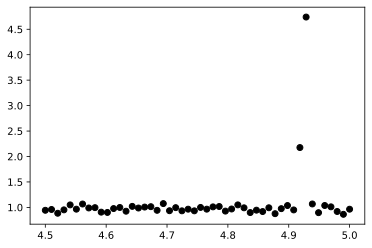

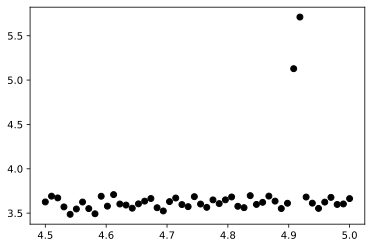

...

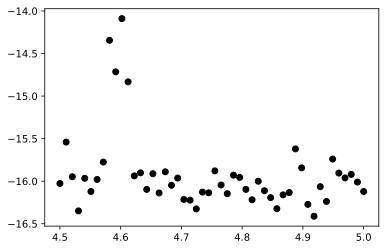

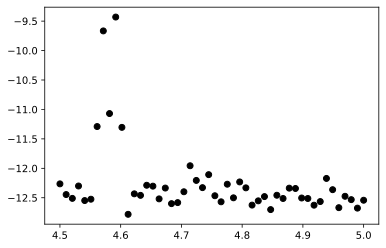

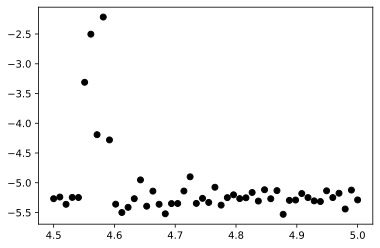

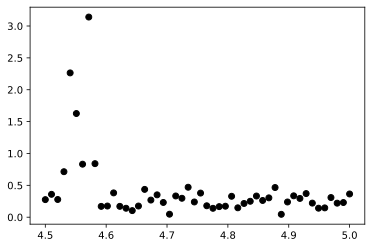

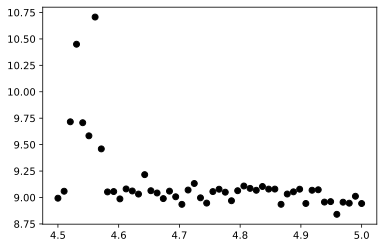

In [36]:
# Plot sample data to get a sense of peak locations
for sweep in real_sweeps:
    plt.scatter(freq_GHz, sweep, color='black')
    plt.show()

In [39]:
# Store rough relative peaks and orientation (whether maxima or minima)
rough_freqs_GHz = [] # Stores extrema as bases for more specific sweeps later
orient = [] # true if extremum = maximum, false if extremum = minimum
for real_sweep in real_sweeps:
    sweep = real_sweep.tolist()
    max_sweep = max(sweep)
    min_sweep = min(sweep)
    mean_sweep = np.mean(sweep)
    max_dist = abs(max_sweep - mean_sweep)
    min_dist = abs(min_sweep - mean_sweep)
    if (max_dist > min_dist): # compare lowest + highest values in sweep to see which is more of an extremum
        rough_freqs_GHz.append(freq_GHz[sweep.index(max_sweep)])
        orient.append(True)
    else:
        rough_freqs_GHz.append(freq_GHz[sweep.index(min_sweep)])
        orient.append(False)

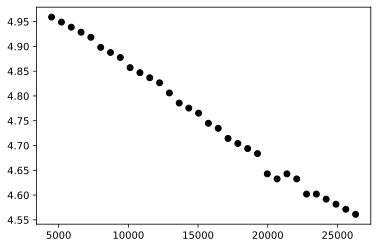

In [40]:
# Observe rough peak frequencies
plt.scatter(cav_durs, rough_freqs_GHz, color='black')
plt.show()

In [48]:
# Create job-specific frequency arrays to perform better sweeps
rough_freqs_Hz = (np.asarray(rough_freqs_GHz) * GHz).tolist()
mod_freqs_GHz = [] # list of freq sweep arrays
mod_freqs_Hz = []
freq_span = 100 * MHz
num_samps = 65

for freq in rough_freqs_Hz: # each approx freq will be the center of its respective sweep
    freq_min = freq - freq_span / 2
    freq_max = freq + freq_span / 2
    freq_GHz = np.linspace(freq_min / GHz, freq_max / GHz, num_samps, endpoint=False)
    freq_Hz = freq_GHz * GHz
    mod_freqs_GHz.append(freq_GHz)
    mod_freqs_Hz.append(freq_Hz)

In [49]:
# Check sample parameters to make sure specific freq arrays assembled properly
mod_freqs_Hz[0], mod_freqs_Hz[31]

(array([4.90918367e+09, 4.91072214e+09, 4.91226060e+09, 4.91379906e+09,
        4.91533752e+09, 4.91687598e+09, 4.91841444e+09, 4.91995290e+09,
        4.92149137e+09, 4.92302983e+09, 4.92456829e+09, 4.92610675e+09,
        4.92764521e+09, 4.92918367e+09, 4.93072214e+09, 4.93226060e+09,
        4.93379906e+09, 4.93533752e+09, 4.93687598e+09, 4.93841444e+09,
        4.93995290e+09, 4.94149137e+09, 4.94302983e+09, 4.94456829e+09,
        4.94610675e+09, 4.94764521e+09, 4.94918367e+09, 4.95072214e+09,
        4.95226060e+09, 4.95379906e+09, 4.95533752e+09, 4.95687598e+09,
        4.95841444e+09, 4.95995290e+09, 4.96149137e+09, 4.96302983e+09,
        4.96456829e+09, 4.96610675e+09, 4.96764521e+09, 4.96918367e+09,
        4.97072214e+09, 4.97226060e+09, 4.97379906e+09, 4.97533752e+09,
        4.97687598e+09, 4.97841444e+09, 4.97995290e+09, 4.98149137e+09,
        4.98302983e+09, 4.98456829e+09, 4.98610675e+09, 4.98764521e+09,
        4.98918367e+09, 4.99072214e+09, 4.99226060e+09, 4.993799

In [50]:
# Assemble modified schedule freqs
mod_schedule_freqs = []
for freq_array in mod_freqs_Hz: 
    mod_schedule_freq = [{drive_chan: freq} for freq in freq_array]
    mod_schedule_freqs.append(mod_schedule_freq)
    
# Modified programs
mod_programs = []
for i in range (len(schedules)):
    mod_program = assemble(schedules[i], backend=backend, meas_level=1, 
                       meas_return='avg', shots=num_shots, schedule_los=mod_schedule_freqs[i])
    mod_programs.append(mod_program)

In [51]:
# Run and store modified jobs
mod_jobs = []
mod_job_IDs = []
j = 0
for mod_program in mod_programs: 
    j += 1
    mod_job = backend.run(mod_program)
    mod_tag = mod_job.job_id()
    print(f"Job {mod_tag} is job number {j}.")
    job_monitor(mod_job)
    mod_jobs.append(mod_job)
    mod_job_IDs.append(mod_tag)

Job 5f30d83875f180001a56f8bf is job number 1.
Job Status: job has successfully run
Job 5f30d8ad5e084e001ae16e6e is job number 2.
Job Status: job has successfully run
Job 5f30d97299148e00191311d2 is job number 3.
Job Status: job has successfully run
Job 5f30da3a252dfd001a348cda is job number 4.
Job Status: job has successfully run
Job 5f30db2c385d440019c44c07 is job number 5.
Job Status: job has successfully run
Job 5f30dc585cf07d001944228e is job number 6.
Job Status: job has successfully run
Job 5f30dd7799148e00191311ff is job number 7.
Job Status: job has successfully run
Job 5f30de5fcc0ccf001947060f is job number 8.
Job Status: job has successfully run
Job 5f30df56a86d70001adfb26f is job number 9.
Job Status: job has successfully run
Job 5f30dfd95e084e001ae16ecd is job number 10.
Job Status: job has successfully run
Job 5f30e0661676e8001ac0a707 is job number 11.
Job Status: job has successfully run
Job 5f30e0f4a86d70001adfb287 is job number 12.
Job Status: job has successfully run
J

In [52]:
# Extract results
mod_real_sweeps = []
for mod_job in mod_jobs:
    mod_real_sweep = np.real(get_job_data(mod_job))
    mod_real_sweeps.append(mod_real_sweep)

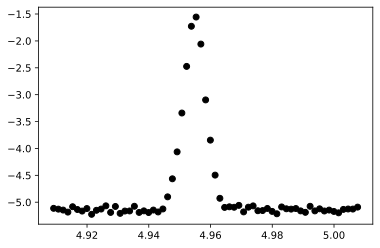

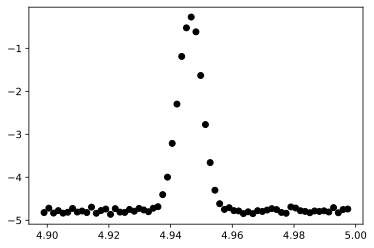

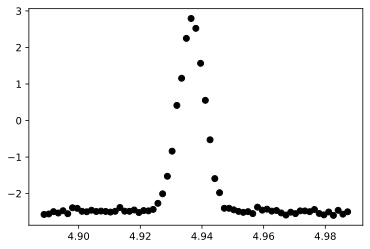

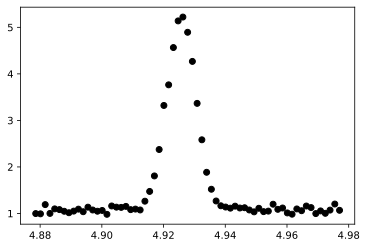

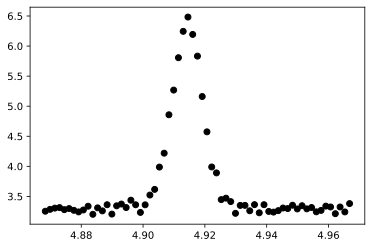

...

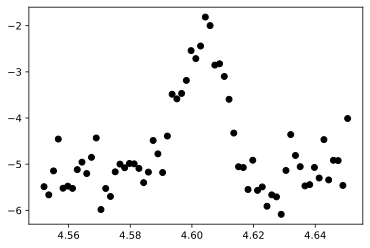

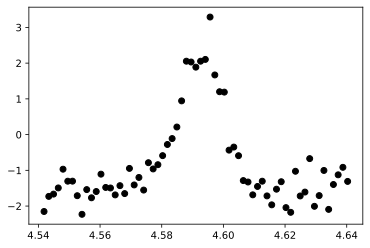

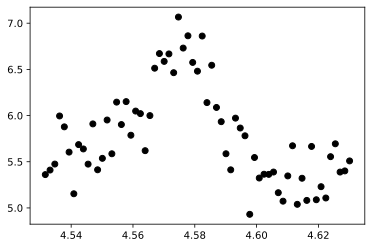

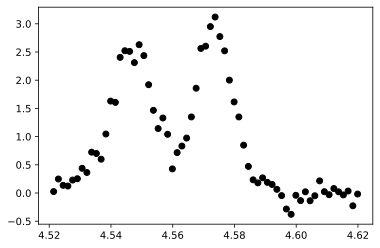

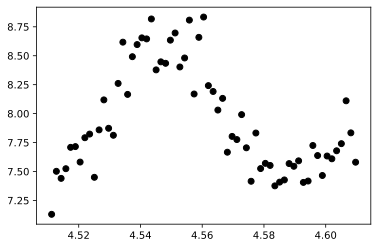

In [53]:
# Plot modified sweep data (each peak should now be central in each plot, with freq boundaries shifting gradually)
for i in range(len(mod_real_sweeps)):
    plt.scatter(mod_freqs_GHz[i], mod_real_sweeps[i], color='black')
    plt.show()

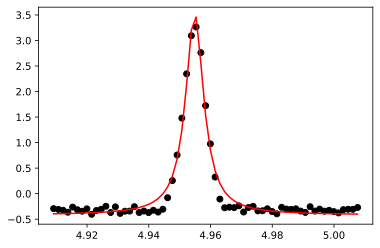

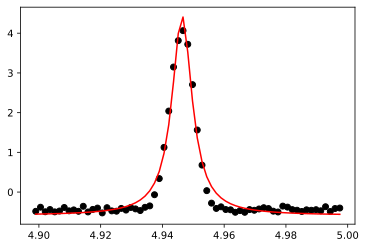

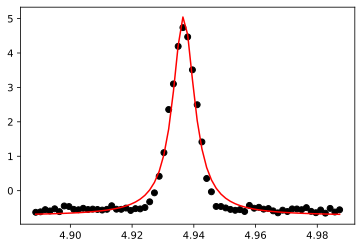

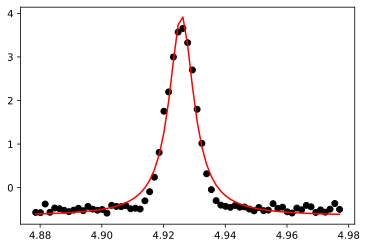

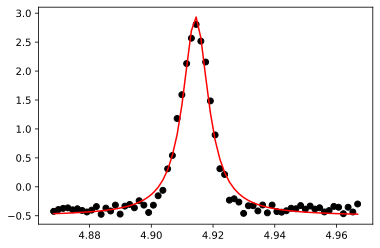

...

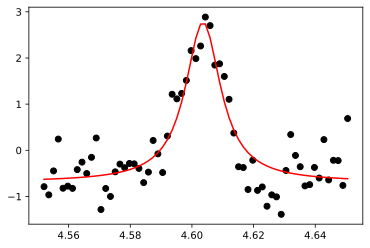

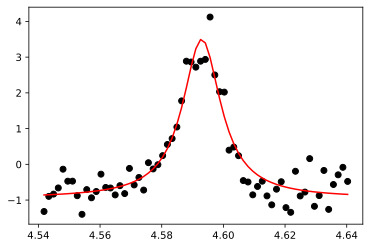

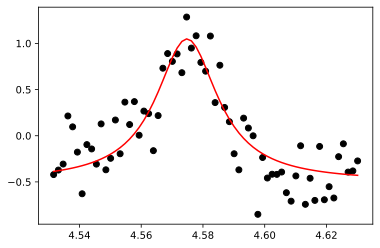

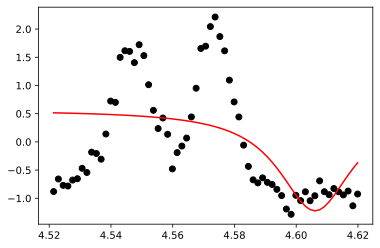

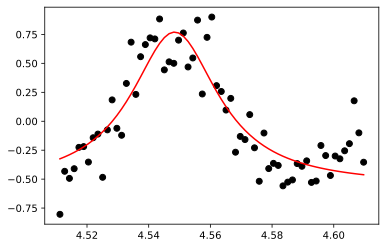

In [54]:
mod_qubit_freqs = [] # For storing centers of peaks based on fits
mod_freq_fits = [] # For storing the functions that fit the sweeps

for i in range(len(mod_real_sweeps)): 
    normalized = mod_real_sweeps[i] - np.mean(mod_real_sweeps[i]) # Shifts each plot down so that asymptotes are ~0
    if (orient[i]): 
        # Positive amplitude fit for plots perceived as having maxima
        params, fit = fit_function(mod_freqs_GHz[i], normalized, 
                    lambda x, A, freq, B, C: (A / np.pi) * (B / ((x - freq)**2 + B**2)) + C,
            [5, rough_freqs_GHz[i], 1, 0]) # initial parameters for curve_fit
    else: 
        # Negative amplitude fit for plots perceived as having minima
        params, fit = fit_function(mod_freqs_GHz[i], normalized, 
                    lambda x, A, freq, B, C: (A / np.pi) * (B / ((x - freq)**2 + B**2)) + C,
            [-5, rough_freqs_GHz[i], 1, 0]) # initial parameters for curve_fit
    plt.scatter(mod_freqs_GHz[i], normalized, color='black')
    plt.plot(mod_freqs_GHz[i], fit, color='red')
    plt.show()
    _, mod_qubit_freq, _, _ = params # Save center of peak
    mod_qubit_freqs.append(mod_qubit_freq)
    mod_freq_fits.append(fit)

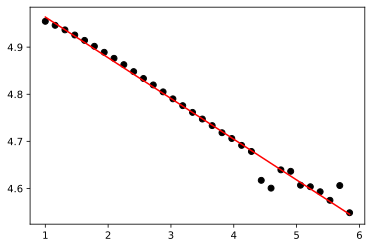

In [80]:
# Check whether duration-frequency relationship is linear
relation_params, relation_fit = fit_function(cav_durs_us, mod_qubit_freqs,
                                            lambda x, A, B: A*x + B,
                                            [-0.1, 5])
slope, y_int = relation_params
plt.scatter(cav_durs_us, mod_qubit_freqs, color='black')
plt.plot(cav_durs_us, relation_fit, color='red')
plt.show()


In [81]:
# Function for removing outliers from line, in order for fit to have more faithful parameters
def remove_lin_outliers(x_data, y_data, slope_guess, y_int_guess, thresh):
    # First fit 'sloppy' line to get approx slope
    fit_params, fit = fit_function(x_data, y_data,
                                    lambda x, A, B: A*x + B,
                                    [slope_guess, y_int_guess])
    this_slope, this_y_int = fit_params
    new_x_data = []
    new_y_data = []
    for i in range(len(x_data)):
        y_obs = y_data[i]
        y_exp = fit[i]
        if (abs(y_obs - y_exp) < thresh):
            new_x_data.append(x_data[i])
            new_y_data.append(y_obs)
    return np.asarray(new_x_data), new_y_data

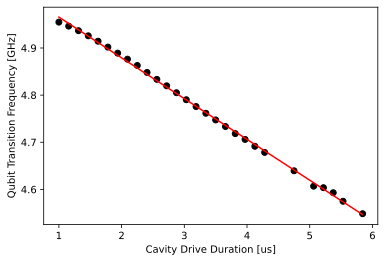

Slope is -0.08650378443050664 GHz/au


In [86]:
resized_cav_durs_us, resized_mod_qubit_freqs = remove_lin_outliers(cav_durs_us, mod_qubit_freqs,
                                                                  -0.1, 5, 0.01)
resized_relation_params, resized_relation_fit = fit_function(resized_cav_durs_us, resized_mod_qubit_freqs,
                                            lambda x, A, B: A*x + B,
                                            [-0.1, 5])

resized_slope, resized_y_int = resized_relation_params

# Plot data with outliers removed
plt.scatter(resized_cav_durs_us, resized_mod_qubit_freqs, color='black')
plt.plot(resized_cav_durs_us, resized_relation_fit, color='red')
plt.xlabel("Cavity Drive Duration [us]")
plt.ylabel("Qubit Transition Frequency [GHz]")
plt.show()

print(f"Slope is {resized_slope} GHz/au")


In [85]:
# Save + store data externally
this_data = {'meas_amp': meas_amp, 'acq_samp_us': acq_samp_us, 'cav_amp': cav_amp, 
             'cav_durs_us': cav_durs_us.tolist(), 'job_IDs': job_IDs, 'rough_freqs_GHz': rough_freqs_GHz, 
             'mod_freq_span': freq_span, 'mod_num_samps': num_samps, 'mod_job_IDs': mod_job_IDs, 
             'mod_qubit_freqs': mod_qubit_freqs, 'slope': slope, 'y_int': y_int, 
             'resized_cav_durs_us': resized_cav_durs_us.tolist(), 'resized_mod_qubit_freqs': resized_mod_qubit_freqs, 
             'resized_slope': resized_slope, 'resized_y_int': resized_y_int}

save_data(this_data, 'PulseDurationvsQubitFrequency.txt')
save_data(this_data, 'PulseDurationvsQubitFrequency_1.txt')
